<a href="https://colab.research.google.com/github/baby1146/baby1146/blob/main/HMM_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install hmmlearn


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 kB 3.5 MB/s eta 0:00:00


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.io import loadmat
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from hmmlearn import hmm
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report
import seaborn as sns

In [3]:
mat_data = loadmat('mixoutALL_shifted.mat')
print(mat_data.keys())


dict_keys(['__header__', '__version__', '__globals__', 'consts', 'mixout'])


In [4]:
consts = mat_data['consts']
print(type(consts[0][0]))

<class 'numpy.void'>


In [5]:
print(consts[0][0].dtype)

[('i', 'O'), ('filename', 'O'), ('penup', 'O'), ('key', 'O'), ('charlabels', 'O'), ('dt', 'O'), ('xtraplen', 'O'), ('sigma', 'O'), ('D', 'O'), ('datarescaled', 'O'), ('units', 'O'), ('datanorm', 'O'), ('N', 'O'), ('maxshift', 'O')]


In [6]:
char_labels = consts[0][0]['charlabels'].squeeze()

In [7]:
sequence_labels = [str(lbl) for lbl in char_labels]

In [8]:
print(sequence_labels)
print(len(sequence_labels))
print(type(sequence_labels))


['1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '2', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3', '3',

In [9]:
data = mat_data['mixout'][0]
labels = mat_data['consts'][0]

In [10]:
print(data)

[array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         -3.32025216e-02, -5.74907689e-02, -8.56596342e-02,
         -1.13578523e-01, -1.39034515e-01, -1.62219529e-01,
         -1.84023319e-01, -2.04616465e-01, -2.23463280e-01,
         -2.39748278e-01, -2.52434892e-01, -2.60490826e-01,
         -2.63607659e-01, -2.62712148e-01, -2.59751112e-01,
         -2.57103618e-01, -2.57071821e-01, -2.61574656e-01,
         -2.72084373e-01, -2.89653713e-01, -3.14666712e-01,
         -3.46308479e-01, -3.82237806e-01, -4.18786327e-01,
         -4.51615545e-01, -4.76666525e-01, -4.91097866e-01,
         -4.93695632e-01, -4.84504451e-01, -4.64107532e-01,
         -4.33241608e-01, -3.92876294e-01, -3.44353610e-01,
         -2.89444691e-01, -2.30532579e-01, -1.70850645e-01,
         -1.14251831e-01, -6.39303552e-02, -2.04578824e-02,
          1.88563646e-02,  5.77134592e-02,  9.76028025e-02,
          1.37219816e-01,  1.74806916e-01,  2.10225327e-01,
          2.44785298e-01,  2.80027919e-0

In [11]:
len(data)

2858

In [12]:
len(labels)

1

In [13]:
trajectories = [data[i].T for i in range(len(data))]

In [14]:
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(sequence_labels)

In [15]:
X_train, X_test, y_train, y_test = train_test_split(
    trajectories, y, test_size=0.3, random_state=42, stratify=y
)

In [16]:
print(X_train)

[array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 1.34907684e-01,  1.01594667e-01,  8.23679370e-02],
       [ 1.41437782e-01,  1.24801535e-01,  1.85562221e-01],
       [ 1.18589392e-01,  1.33240196e-01,  3.32378686e-01],
       [ 7.42121808e-02,  1.26498246e-01,  5.00090599e-01],
       [ 2.09419726e-02,  1.09549718e-01,  6.55175560e-01],
       [-3.37257122e-02,  8.88869783e-02,  7.72005135e-01],
       [-9.02017848e-02,  6.91852901e-02,  8.45244225e-01],
       [-1.53326493e-01,  5.20954967e-02,  8.85646463e-01],
       [-2.28163686e-01,  3.69709279e-02,  9.06906309e-01],
       [-3.17701117e-01,  2.24802031e-0

In [17]:
print(X_test)

[array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 4.99298605e-02,  2.42217297e-01,  1.05758084e+00],
       [ 3.67953497e-02,  2.97879599e-01,  1.34780929e+00],
       [ 8.03584725e-04,  3.21862243e-01,  1.52009595e+00],
       [-5.55314252e-02,  3.14003586e-01,  1.55713721e+00],
       [-1.25774965e-01,  2.83944159e-01,  1.48765938e+00],
       [-2.02972899e-01,  2.43104479e-0

In [18]:
print(y_train)

[16 12  3 ...  7  1 15]


In [19]:
print(y_test)

[ 0 15 16  5  9 12 18  9 18  9  0  4 15  7  8 14 10 16  6 12 14 19 16  2
 18  2 12 12  0 14  8 15 18 10  6 17 14 11  6 17  7  5  3  7  4  6  9 16
 10  3 17  6 12 10 11  8  9 17 12  6  7 16 10  7 12  0  2  1 12 13 17  8
  2 16  1 11  7  0 12 17 10  3 13  3  2 14  3 15  2 15  4  7 16  1 11  4
  8  0 16 11 16  0 17 11  5 18 17 19  8 13  6  9 11 18  9 14 10 12 14  7
 11 16 19  1  3  8  8 16 16  5 12  8  5  0  2  7 12 19  0 13  1  0  7  2
  5  1  8 10 19  5 19 17  8 10  0 18  1 18  2  6  9 17 12  3  9  1 18  4
 15 15 10  8  7  9  3 14 12  6 11 19  9  9 13 10  8 10  0  1 18  6 15  0
 14  9  9 12 14 15 14 11  0 15 15 18 18  8  0 14  3  3 10  0  1  4 16 10
 12  7 18 12 13 11  8  2 14  9  9 17  4 13 13 15 17  3  0 14 15 18  7 12
 19  0  8 11  7  8  3  8  6 13  4  2  8 13  8  3  5  7 11  5 19 18 18 17
 13  3 19  3 10  6  4 11 13  8  8 14 16 15 15 12 15 18  7  7  2 12  2  7
 12 19 18 16  7 18  8  3 13  8  4  0 16  0  5 12 12 12 16  7  6  5 13 10
 17 15 14 17 19 10  6  1  8 15  3 16  0 16 10 13 17

In [20]:
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

In [21]:
from hmmlearn.hmm import GaussianHMM
n_components = 4
models = {}

for class_idx in np.unique(y_train):
    # Get all sequences for this class
    class_sequences = [X_train[i] for i in range(len(X_train)) if y_train[i] == class_idx]

    # Concatenate all sequences into one big sequence
    lengths = [len(seq) for seq in class_sequences]
    X_concat = np.concatenate(class_sequences)

    # Fit HMM
    model = GaussianHMM(n_components=n_components, covariance_type="diag", n_iter=100, tol=1e-4, verbose=True)
    model.fit(X_concat, lengths)
    models[class_idx] = model

         1  -73425.70778889             +nan
         2  -51881.29268160  +21544.41510729
         3  -41195.73964609  +10685.55303551
         4  -34402.54977551   +6793.18987058
         5  -27162.99231427   +7239.55746123
         6  -21829.57233494   +5333.41997933
         7  -14990.20828196   +6839.36405298
         8   -9400.27294824   +5589.93533372
         9   -3330.59889987   +6069.67404837
        10    3041.87467392   +6372.47357379
        11    9478.38150667   +6436.50683276
        12   17772.33000741   +8293.94850074
        13   23971.98824710   +6199.65823969
        14   26206.48023630   +2234.49198920
        15   27809.44520398   +1602.96496768
        16   28542.29457887    +732.84937489
        17   28691.51653764    +149.22195877
        18   28748.16199709     +56.64545944
        19   28772.89447225     +24.73247517
        20   28784.06864311     +11.17417086
        21   28789.17323231      +5.10458920
        22   28791.50898709      +2.33575478
        23

In [22]:
# Step 6: Predict on test set
y_pred = []
for seq in X_test:
    scores = {cls: model.score(seq) for cls, model in models.items()}
    pred_class = max(scores, key=scores.get)
    y_pred.append(pred_class)


In [23]:
print(len(y_pred))

858


In [24]:
print(len(y_test))

858


In [25]:
print(np.unique(y_pred))

[ 1  2  3  4  6  8  9 12 13 14 15 16 17 18 19]


In [26]:
print(np.unique(y_test))

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]


In [27]:
print(len(X_test))

858


In [28]:
print(len(X_train))

2000


In [29]:
# Step 7: Accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test, y_pred)
print(f"✅ Test Accuracy: {accuracy * 100:.2f}%")

✅ Test Accuracy: 51.28%


In [30]:
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    classification_report,
    log_loss,
    roc_auc_score,
    ConfusionMatrixDisplay
)

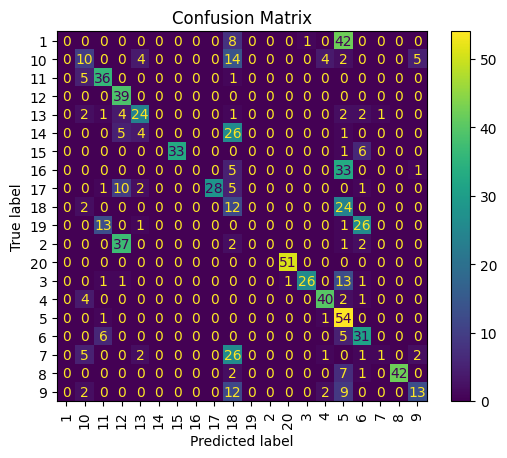

In [31]:
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(xticks_rotation=90)
plt.title("Confusion Matrix")
plt.show()

In [32]:
report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
print("📝 Classification Report:\n", report)

📝 Classification Report:
               precision    recall  f1-score   support

           1       0.00      0.00      0.00        51
          10       0.33      0.26      0.29        39
          11       0.61      0.86      0.71        42
          12       0.41      1.00      0.58        39
          13       0.65      0.65      0.65        37
          14       0.00      0.00      0.00        36
          15       1.00      0.82      0.90        40
          16       0.00      0.00      0.00        39
          17       1.00      0.60      0.75        47
          18       0.11      0.32      0.16        38
          19       0.00      0.00      0.00        41
           2       0.00      0.00      0.00        42
          20       0.98      1.00      0.99        51
           3       0.96      0.60      0.74        43
           4       0.83      0.85      0.84        47
           5       0.27      0.96      0.43        56
           6       0.43      0.74      0.54        42
 

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [33]:
import numpy as np

# Step: Build pseudo-probability scores from log-likelihoods
y_proba = []

for seq in X_test:
    scores = {cls: model.score(seq) for cls, model in models.items()}  # log-likelihoods
    max_score = max(scores.values())

    # Convert log-likelihoods to softmax-like probabilities
    probs = np.exp([scores[cls] - max_score for cls in sorted(models.keys())])
    probs = probs / np.sum(probs)

    y_proba.append(probs)

y_proba = np.array(y_proba)

In [34]:

try:
    loss = log_loss(y_test, y_proba)
    print(f"📉 Log Loss: {loss:.4f}")
except:
    print("⚠️ log_loss requires `y_proba` as predicted probabilities (2D array)")

📉 Log Loss: 15.2295


log loss should be between 3 to 4

log loss value is much higher , so according to this model not recommanded

In [35]:
try:
    if len(np.unique(y_test)) == 2:
        auc = roc_auc_score(y_test, y_proba[:, 1])
        print(f"🎯 ROC-AUC (Binary): {auc:.4f}")
    else:
        auc = roc_auc_score(
            y_test, y_proba, multi_class='ovr', average='macro'
        )
        print(f"🎯 ROC-AUC (Multiclass OVR): {auc:.4f}")
except:
    print("⚠️ ROC-AUC requires `y_proba` and numeric `y_test` labels")

🎯 ROC-AUC (Multiclass OVR): 0.9011


Roc is correct , because it lies between 0 to 1

In [36]:
print(y_proba[0])

[2.61269287e-256 2.65370830e-024 1.86651669e-044 6.05574017e-199
 6.98599647e-112 0.00000000e+000 1.96848568e-303 0.00000000e+000
 2.04460408e-250 9.93325695e-001 0.00000000e+000 0.00000000e+000
 0.00000000e+000 1.61756511e-067 2.04726106e-074 6.67430520e-003
 1.42289376e-055 6.28672679e-036 4.33778838e-094 2.08324384e-026]


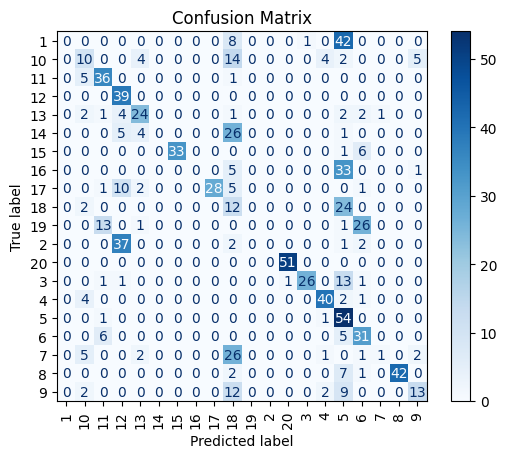

In [37]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(xticks_rotation=90, cmap="Blues")
plt.title("Confusion Matrix")
plt.grid(False)
plt.show()

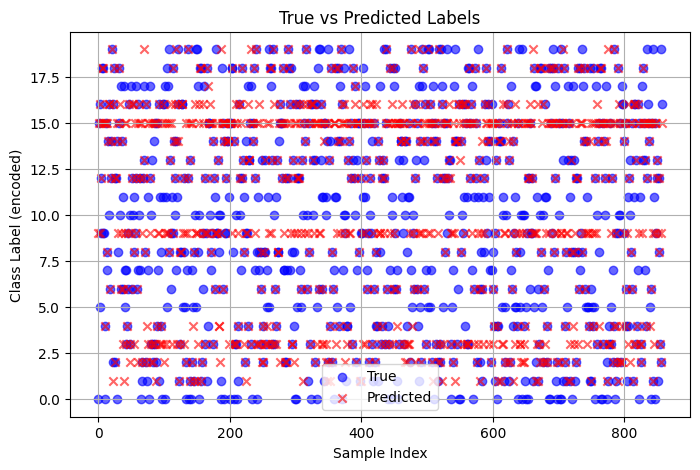

In [38]:
import numpy as np

plt.figure(figsize=(8, 5))
plt.scatter(range(len(y_test)), y_test, label='True', marker='o', color='blue', alpha=0.6)
plt.scatter(range(len(y_pred)), y_pred, label='Predicted', marker='x', color='red', alpha=0.6)
plt.title("True vs Predicted Labels")
plt.xlabel("Sample Index")
plt.ylabel("Class Label (encoded)")
plt.legend()
plt.grid(True)
plt.show()


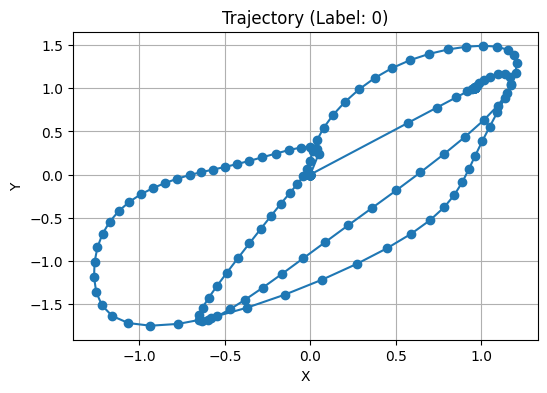

In [39]:
def plot_sample_trajectory(sample, label):
    plt.figure(figsize=(6, 4))
    plt.plot(sample[:, 0], sample[:, 1], marker='o')
    plt.title(f"Trajectory (Label: {label})")
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.grid(True)
    plt.show()

# Example: Plot the first trajectory
plot_sample_trajectory(X_test[0], y_test[0])

In [40]:
X_flat = np.array([np.mean(seq, axis=0) for seq in X_test])

In [41]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

# Option 1: PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_flat)

# Option 2: t-SNE (slower but better separation)
tsne = TSNE(n_components=2, random_state=42, perplexity=20)
X_tsne = tsne.fit_transform(X_flat)

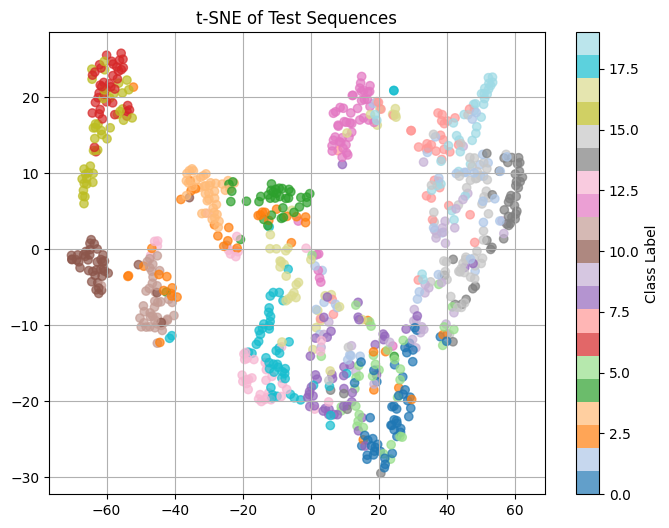

In [42]:
def plot_embedding(X_embedded, labels, title="2D Embedding"):
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=labels, cmap='tab20', alpha=0.7)
    plt.colorbar(scatter, label="Class Label")
    plt.title(title)
    plt.grid(True)
    plt.show()

plot_embedding(X_tsne, y_test, title="t-SNE of Test Sequences")

In [43]:
confidence_scores = []

for seq in X_test:
    scores = {cls: model.score(seq) for cls, model in models.items()}
    pred_class = max(scores, key=scores.get)
    y_pred.append(pred_class)               # Already exists
    confidence_scores.append(scores[pred_class])  # Add this line

In [44]:
y_pred = np.array(y_pred[:len(y_test)]).flatten()
y_test = np.array(y_test).flatten()

correct = y_pred == y_test


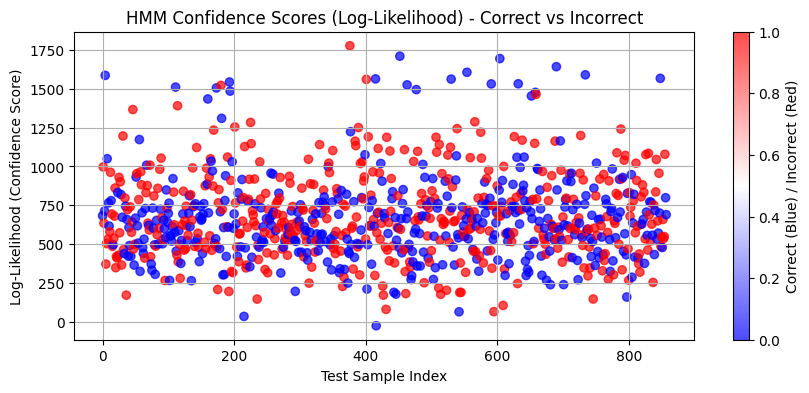

In [45]:
import numpy as np
import matplotlib.pyplot as plt


plt.figure(figsize=(10, 4))
plt.scatter(range(len(confidence_scores)), confidence_scores, c=correct, cmap="bwr", alpha=0.7)
plt.title("HMM Confidence Scores (Log-Likelihood) - Correct vs Incorrect")
plt.xlabel("Test Sample Index")
plt.ylabel("Log-Likelihood (Confidence Score)")
plt.colorbar(label="Correct (Blue) / Incorrect (Red)")
plt.grid(True)
plt.show()